In [47]:
# Importing library
%matplotlib inline
import warnings
warnings.filterwarnings('ignore')
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
from plotnine import *
import numpy as np
from pathlib import Path

## Reading the Data

In [2]:
# Loading the dataset
main_df = pd.read_csv("../Resources/DataCoSupplyChainDataset.csv", encoding= 'unicode_escape')
main_df.head()

,Type,Days for shipping (real),Days for shipment (scheduled),Benefit per order,Sales per customer,Delivery Status,Late_delivery_risk,Category Id,Category Name,Customer City,...,Order Zipcode,Product Card Id,Product Category Id,Product Description,Product Image,Product Name,Product Price,Product Status,shipping date (DateOrders),Shipping Mode
0,DEBIT,3,4,91.250000,314.640015,Advance shipping,0,73,Sporting Goods,Caguas,...,NaN,1360,73,NaN,http://images.acmesports.sports/Smart+watch,Smart watch,327.75,0,2/3/2018 22:56,Standard Class
1,TRANSFER,5,4,-249.089996,311.359985,Late delivery,1,73,Sporting Goods,Caguas,...,NaN,1360,73,NaN,http://images.acmesports.sports/Smart+watch,Smart watch,327.75,0,1/18/2018 12:27,Standard Class
2,CASH,4,4,-247.779999,309.720001,Shipping on time,0,73,Sporting Goods,San Jose,...,NaN,1360,73,NaN,http://images.acmesports.sports/Smart+watch,Smart watch,327.75,0,1/17/2018 12:06,Standard Class
3,DEBIT,3,4,22.860001,304.809998,Advance shipping,0,73,Sporting Goods,Los Angeles,...,NaN,1360,73,NaN,http://images.acmesports.sports/Smart+watch,Smart watch,327.75,0,1/16/2018 11:45,Standard Class
4,PAYMENT,2,4,134.210007,298.250000,Advance shipping,0,73,Sporting Goods,Caguas,...,NaN,1360,73,NaN,http://images.acmesports.sports/Smart+watch,Smart watch,327.75,0,1/15/2018 11:24,Standard Class


## Data Cleaning and Preparation

In [13]:
# Get the names of the columns
main_df.columns

Index(['Type', 'Days_for_shipping_(real)', 'Days_for_shipment_(scheduled)',
       'Benefit_per_order', 'Sales_per_customer', 'Delivery_Status',
       'Late_delivery_risk', 'Category_Id', 'Category_Name', 'Customer_City',
       'Customer_Country', 'Customer_Email', 'Customer_Fname', 'Customer_Id',
       'Customer_Lname', 'Customer_Password', 'Customer_Segment',
       'Customer_State', 'Customer_Street', 'Customer_Zipcode',
       'Department_Id', 'Department_Name', 'Latitude', 'Longitude', 'Market',
       'Order_City', 'Order_Country', 'Order_Customer_Id',
       'order_date_(DateOrders)', 'Order_Id', 'Order_Item_Cardprod_Id',
       'Order_Item_Discount', 'Order_Item_Discount_Rate', 'Order_Item_Id',
       'Order_Item_Product_Price', 'Order_Item_Profit_Ratio',
       'Order_Item_Quantity', 'Sales', 'Order_Item_Total',
       'Order_Profit_Per_Order', 'Order_Region', 'Order_State', 'Order_Status',
       'Order_Zipcode', 'Product_Card_Id', 'Product_Category_Id',
       'Product_De

In [14]:
# Replacing " " by "_"
main_df.columns = main_df.columns.str.replace(' ', '_')
main_df.head()

,Type,Days_for_shipping_(real),Days_for_shipment_(scheduled),Benefit_per_order,Sales_per_customer,Delivery_Status,Late_delivery_risk,Category_Id,Category_Name,Customer_City,...,Order_Zipcode,Product_Card_Id,Product_Category_Id,Product_Description,Product_Image,Product_Name,Product_Price,Product_Status,shipping_date_(DateOrders),Shipping_Mode
0,DEBIT,3,4,91.250000,314.640015,Advance shipping,0,73,Sporting Goods,Caguas,...,NaN,1360,73,NaN,http://images.acmesports.sports/Smart+watch,Smart watch,327.75,0,2/3/2018 22:56,Standard Class
1,TRANSFER,5,4,-249.089996,311.359985,Late delivery,1,73,Sporting Goods,Caguas,...,NaN,1360,73,NaN,http://images.acmesports.sports/Smart+watch,Smart watch,327.75,0,1/18/2018 12:27,Standard Class
2,CASH,4,4,-247.779999,309.720001,Shipping on time,0,73,Sporting Goods,San Jose,...,NaN,1360,73,NaN,http://images.acmesports.sports/Smart+watch,Smart watch,327.75,0,1/17/2018 12:06,Standard Class
3,DEBIT,3,4,22.860001,304.809998,Advance shipping,0,73,Sporting Goods,Los Angeles,...,NaN,1360,73,NaN,http://images.acmesports.sports/Smart+watch,Smart watch,327.75,0,1/16/2018 11:45,Standard Class
4,PAYMENT,2,4,134.210007,298.250000,Advance shipping,0,73,Sporting Goods,Caguas,...,NaN,1360,73,NaN,http://images.acmesports.sports/Smart+watch,Smart watch,327.75,0,1/15/2018 11:24,Standard Class


In [15]:
# Check for Null or NaNs
main_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 180519 entries, 0 to 180518
Data columns (total 53 columns):
 #   Column                         Non-Null Count   Dtype  
---  ------                         --------------   -----  
 0   Type                           180519 non-null  object 
 1   Days_for_shipping_(real)       180519 non-null  int64  
 2   Days_for_shipment_(scheduled)  180519 non-null  int64  
 3   Benefit_per_order              180519 non-null  float64
 4   Sales_per_customer             180519 non-null  float64
 5   Delivery_Status                180519 non-null  object 
 6   Late_delivery_risk             180519 non-null  int64  
 7   Category_Id                    180519 non-null  int64  
 8   Category_Name                  180519 non-null  object 
 9   Customer_City                  180519 non-null  object 
 10  Customer_Country               180519 non-null  object 
 11  Customer_Email                 180519 non-null  object 
 12  Customer_Fname                

In [16]:
# Creating a clean DataFrame after dropping null values
data1_df = main_df.dropna(axis = 'columns')
data1_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 180519 entries, 0 to 180518
Data columns (total 49 columns):
 #   Column                         Non-Null Count   Dtype  
---  ------                         --------------   -----  
 0   Type                           180519 non-null  object 
 1   Days_for_shipping_(real)       180519 non-null  int64  
 2   Days_for_shipment_(scheduled)  180519 non-null  int64  
 3   Benefit_per_order              180519 non-null  float64
 4   Sales_per_customer             180519 non-null  float64
 5   Delivery_Status                180519 non-null  object 
 6   Late_delivery_risk             180519 non-null  int64  
 7   Category_Id                    180519 non-null  int64  
 8   Category_Name                  180519 non-null  object 
 9   Customer_City                  180519 non-null  object 
 10  Customer_Country               180519 non-null  object 
 11  Customer_Email                 180519 non-null  object 
 12  Customer_Fname                

### Observation:
With this action, we droped the following columns:
- Customer_Lname
- Customer_Zipcode
- Order_Zipcode
- Product_Description

In addition to this, we will drop `Product_Image`, `Customer_Fname` and `Department_Name` since they are not required for the analysis.

In [22]:
# Drop `Product_Image` column
data2_df = data1_df.drop(['Product_Image', 'Customer_Fname', 
                          'Department_Name'], axis = 1)
data2_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 180519 entries, 0 to 180518
Data columns (total 46 columns):
 #   Column                         Non-Null Count   Dtype  
---  ------                         --------------   -----  
 0   Type                           180519 non-null  object 
 1   Days_for_shipping_(real)       180519 non-null  int64  
 2   Days_for_shipment_(scheduled)  180519 non-null  int64  
 3   Benefit_per_order              180519 non-null  float64
 4   Sales_per_customer             180519 non-null  float64
 5   Delivery_Status                180519 non-null  object 
 6   Late_delivery_risk             180519 non-null  int64  
 7   Category_Id                    180519 non-null  int64  
 8   Category_Name                  180519 non-null  object 
 9   Customer_City                  180519 non-null  object 
 10  Customer_Country               180519 non-null  object 
 11  Customer_Email                 180519 non-null  object 
 12  Customer_Id                   

### Verifying attributes without variance
Columns without any variance can also be excluded from the dataset

In [23]:
# Create a function to scan the dataset for attributes without variance

def check_variance(data, log=False):
    
    no_variance_cols = []
    for i in data.dtypes.index:
        number_unique = len(data[i].value_counts())
        if number_unique == 1:
            print(i, "Unique Value: {}".format(data[i].value_counts().index[0]))
            no_variance_cols.append(i)
        
    if log:
        return no_variance_cols, {"No variability in attribute(s):": no_variance_cols}
    else:            
        return no_variance_cols

no_variance_cols, variance_log = check_variance(data2_df, log=True)


Customer_Email Unique Value: XXXXXXXXX
Customer_Password Unique Value: XXXXXXXXX
Product_Status Unique Value: 0


As we can observe, there are three more columns to be dropped from our dataset, since they don't add avalue in our analysis

In [24]:
# Drop columns with no variance
data3_df = data2_df.drop(columns = no_variance_cols)
data3_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 180519 entries, 0 to 180518
Data columns (total 43 columns):
 #   Column                         Non-Null Count   Dtype  
---  ------                         --------------   -----  
 0   Type                           180519 non-null  object 
 1   Days_for_shipping_(real)       180519 non-null  int64  
 2   Days_for_shipment_(scheduled)  180519 non-null  int64  
 3   Benefit_per_order              180519 non-null  float64
 4   Sales_per_customer             180519 non-null  float64
 5   Delivery_Status                180519 non-null  object 
 6   Late_delivery_risk             180519 non-null  int64  
 7   Category_Id                    180519 non-null  int64  
 8   Category_Name                  180519 non-null  object 
 9   Customer_City                  180519 non-null  object 
 10  Customer_Country               180519 non-null  object 
 11  Customer_Id                    180519 non-null  int64  
 12  Customer_Segment              

## Checking for redundancies

In order to check for redundancies in our dataset, we will create a matrix for better identification

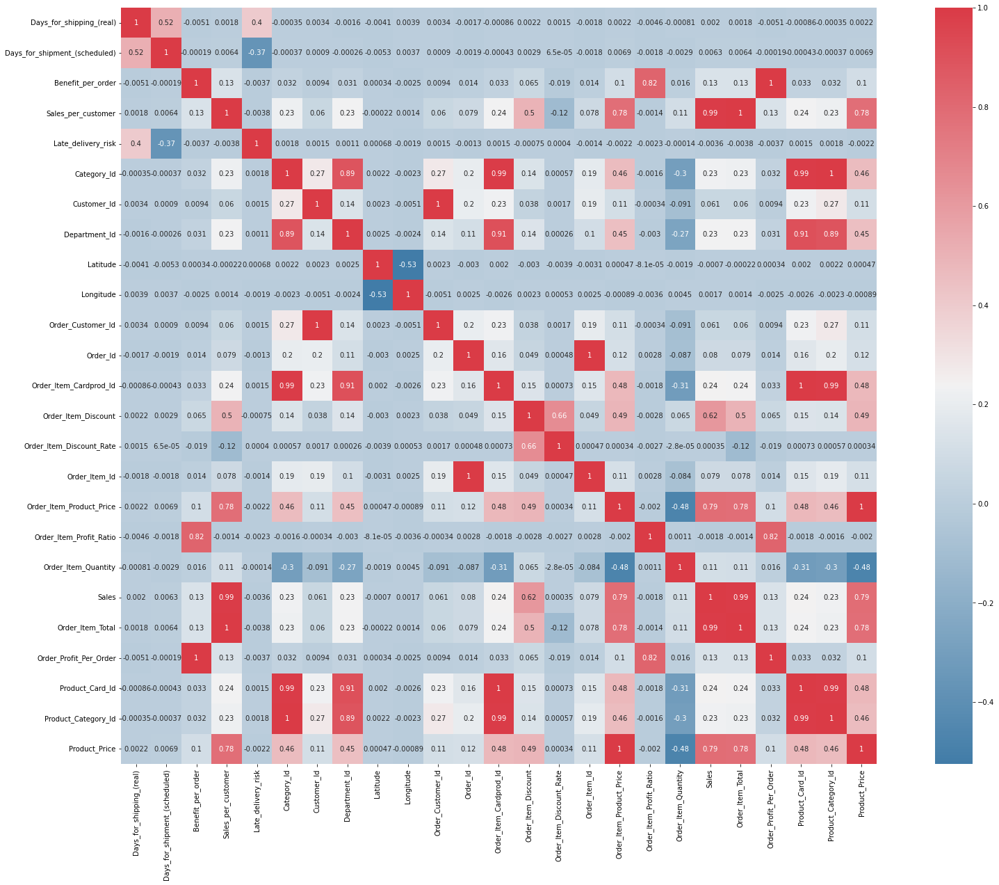

In [27]:
# Creating a correlation matrix between variables
n_colors = 256 # Use 256 colors for the diverging color palette
corr = data3_df.corr()
plt.figure(figsize=(30, 20))
ax = sns.heatmap(corr, 
                 annot = True, 
                 cmap = sns.diverging_palette(240, 10, n = n_colors),
                 square = True)

### Observations

By reviewing the matrix we found that the following colimns contain same data

- Benefit_per_order and Order_Profit_Per_Order
- Sales_per_customer and Order_Item_Total
- Category_Id and Product_Category_Id
- Customer_Id and Order_Customer_Id
- Order_Id and Order_Item_Id
- Order_Item_Cardprod_Id and Product_Card_Id
- Order_Item_Product_Price and Product_Price

In [28]:
# Droping redundant columns
clean_df = data3_df.drop(['Order_Profit_Per_Order', 'Order_Item_Total', 'Product_Category_Id', 
                         'Order_Customer_Id', 'Order_Item_Id', 'Order_Item_Cardprod_Id', 
                         'Order_Item_Product_Price'], axis = 1)
print(f"The total of columns of clean data are: {len(clean_df.columns)}")

The total of columns of clean data are: 36


In [29]:
# Converting `shipping_date_(DateOrders)` to datetime
clean_df['shipping_date_(DateOrders)'] = pd.to_datetime(clean_df['shipping_date_(DateOrders)'])
clean_df.head()

,Type,Days_for_shipping_(real),Days_for_shipment_(scheduled),Benefit_per_order,Sales_per_customer,Delivery_Status,Late_delivery_risk,Category_Id,Category_Name,Customer_City,...,Order_Item_Quantity,Sales,Order_Region,Order_State,Order_Status,Product_Card_Id,Product_Name,Product_Price,shipping_date_(DateOrders),Shipping_Mode
0,DEBIT,3,4,91.250000,314.640015,Advance shipping,0,73,Sporting Goods,Caguas,...,1,327.75,Southeast Asia,Java Occidental,COMPLETE,1360,Smart watch,327.75,2018-02-03 22:56:00,Standard Class
1,TRANSFER,5,4,-249.089996,311.359985,Late delivery,1,73,Sporting Goods,Caguas,...,1,327.75,South Asia,Rajastán,PENDING,1360,Smart watch,327.75,2018-01-18 12:27:00,Standard Class
2,CASH,4,4,-247.779999,309.720001,Shipping on time,0,73,Sporting Goods,San Jose,...,1,327.75,South Asia,Rajastán,CLOSED,1360,Smart watch,327.75,2018-01-17 12:06:00,Standard Class
3,DEBIT,3,4,22.860001,304.809998,Advance shipping,0,73,Sporting Goods,Los Angeles,...,1,327.75,Oceania,Queensland,COMPLETE,1360,Smart watch,327.75,2018-01-16 11:45:00,Standard Class
4,PAYMENT,2,4,134.210007,298.250000,Advance shipping,0,73,Sporting Goods,Caguas,...,1,327.75,Oceania,Queensland,PENDING_PAYMENT,1360,Smart watch,327.75,2018-01-15 11:24:00,Standard Class


In [34]:
# Saving the clean DataFrame into a csv file
clean_df.to_csv('../Resources/CleanDataCoDataset.csv.zip', encoding = 'utf-8', 
                index = False, compression = 'zip')

## What factors are impacting the supply chain disruptions?
Lets visualize the impact of late deliveries

<AxesSubplot:xlabel='Days_for_shipment_(scheduled)', ylabel='Days_for_shipping_(real)'>

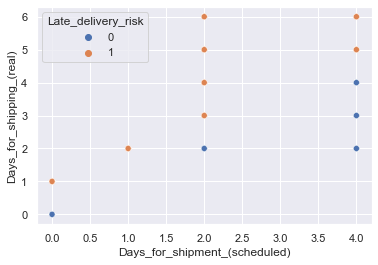

In [35]:
# plot varible analysis for delivery risk where 0 = on time and 1 = late delivery
sns.set()
sns.scatterplot(x = "Days_for_shipment_(scheduled)", 
                  y = "Days_for_shipping_(real)", hue = "Late_delivery_risk", data = clean_df)

Shipments are late for all the schedules, with higher risk on 2 days scheduled shipment

In [36]:
# Get the names of the columns
clean_df.columns

Index(['Type', 'Days_for_shipping_(real)', 'Days_for_shipment_(scheduled)',
       'Benefit_per_order', 'Sales_per_customer', 'Delivery_Status',
       'Late_delivery_risk', 'Category_Id', 'Category_Name', 'Customer_City',
       'Customer_Country', 'Customer_Id', 'Customer_Segment', 'Customer_State',
       'Customer_Street', 'Department_Id', 'Latitude', 'Longitude', 'Market',
       'Order_City', 'Order_Country', 'order_date_(DateOrders)', 'Order_Id',
       'Order_Item_Discount', 'Order_Item_Discount_Rate',
       'Order_Item_Profit_Ratio', 'Order_Item_Quantity', 'Sales',
       'Order_Region', 'Order_State', 'Order_Status', 'Product_Card_Id',
       'Product_Name', 'Product_Price', 'shipping_date_(DateOrders)',
       'Shipping_Mode'],
      dtype='object')

# Splitting dataset

## Shipment dataset

In [38]:
# Creating shipment dataset
shipment = ['Type', 'Days_for_shipping_(real)', 'Days_for_shipment_(scheduled)', 'Late_delivery_risk', 
            'Benefit_per_order', 'Sales_per_customer', 'Market', 'Latitude', 'Longitude', 'Shipping_Mode', 
            'Order_Id', 'Order_Status', 'Order_Region', 'Order_Country', 'Order_City', 
            'Delivery_Status', 'shipping_date_(DateOrders)']
shipment_df = clean_df[shipment]
shipment_df.head()

,Type,Days_for_shipping_(real),Days_for_shipment_(scheduled),Late_delivery_risk,Benefit_per_order,Sales_per_customer,Market,Latitude,Longitude,Shipping_Mode,Order_Id,Order_Status,Order_Region,Order_Country,Order_City,Delivery_Status,shipping_date_(DateOrders)
0,DEBIT,3,4,0,91.250000,314.640015,Pacific Asia,18.251453,-66.037056,Standard Class,77202,COMPLETE,Southeast Asia,Indonesia,Bekasi,Advance shipping,2018-02-03 22:56:00
1,TRANSFER,5,4,1,-249.089996,311.359985,Pacific Asia,18.279451,-66.037064,Standard Class,75939,PENDING,South Asia,India,Bikaner,Late delivery,2018-01-18 12:27:00
2,CASH,4,4,0,-247.779999,309.720001,Pacific Asia,37.292233,-121.881279,Standard Class,75938,CLOSED,South Asia,India,Bikaner,Shipping on time,2018-01-17 12:06:00
3,DEBIT,3,4,0,22.860001,304.809998,Pacific Asia,34.125946,-118.291016,Standard Class,75937,COMPLETE,Oceania,Australia,Townsville,Advance shipping,2018-01-16 11:45:00
4,PAYMENT,2,4,0,134.210007,298.250000,Pacific Asia,18.253769,-66.037048,Standard Class,75936,PENDING_PAYMENT,Oceania,Australia,Townsville,Advance shipping,2018-01-15 11:24:00


In [39]:
shipment_df['year'] = pd.DatetimeIndex(shipment_df['shipping_date_(DateOrders)']).year
shipment_df['month'] = pd.DatetimeIndex(shipment_df['shipping_date_(DateOrders)']).month
shipment_df.head()

/var/folders/b2/twj0gkts6fgb95d9zwc0sy1m0000gn/T/ipykernel_88934/1209993825.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  shipment_df['year'] = pd.DatetimeIndex(shipment_df['shipping_date_(DateOrders)']).year
/var/folders/b2/twj0gkts6fgb95d9zwc0sy1m0000gn/T/ipykernel_88934/1209993825.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  shipment_df['month'] = pd.DatetimeIndex(shipment_df['shipping_date_(DateOrders)']).month


,Type,Days_for_shipping_(real),Days_for_shipment_(scheduled),Late_delivery_risk,Benefit_per_order,Sales_per_customer,Market,Latitude,Longitude,Shipping_Mode,Order_Id,Order_Status,Order_Region,Order_Country,Order_City,Delivery_Status,shipping_date_(DateOrders),year,month
0,DEBIT,3,4,0,91.250000,314.640015,Pacific Asia,18.251453,-66.037056,Standard Class,77202,COMPLETE,Southeast Asia,Indonesia,Bekasi,Advance shipping,2018-02-03 22:56:00,2018,2
1,TRANSFER,5,4,1,-249.089996,311.359985,Pacific Asia,18.279451,-66.037064,Standard Class,75939,PENDING,South Asia,India,Bikaner,Late delivery,2018-01-18 12:27:00,2018,1
2,CASH,4,4,0,-247.779999,309.720001,Pacific Asia,37.292233,-121.881279,Standard Class,75938,CLOSED,South Asia,India,Bikaner,Shipping on time,2018-01-17 12:06:00,2018,1
3,DEBIT,3,4,0,22.860001,304.809998,Pacific Asia,34.125946,-118.291016,Standard Class,75937,COMPLETE,Oceania,Australia,Townsville,Advance shipping,2018-01-16 11:45:00,2018,1
4,PAYMENT,2,4,0,134.210007,298.250000,Pacific Asia,18.253769,-66.037048,Standard Class,75936,PENDING_PAYMENT,Oceania,Australia,Townsville,Advance shipping,2018-01-15 11:24:00,2018,1


In [76]:
# Creating pivot table Delivery Status by Year
delivery_df = pd.pivot_table(shipment_df, 
                            index = 'year', 
                            columns = 'Delivery_Status', 
                            values = 'Order_Id', 
                            aggfunc = 'count')
delivery_df


Delivery_Status,Advance shipping,Late delivery,Shipping canceled,Shipping on time
year,,,,
2015,14498,33940,2672,10892
2016,14206,34514,2620,11262
2017,12371,29178,2366,9631
2018,517,1345,96,411


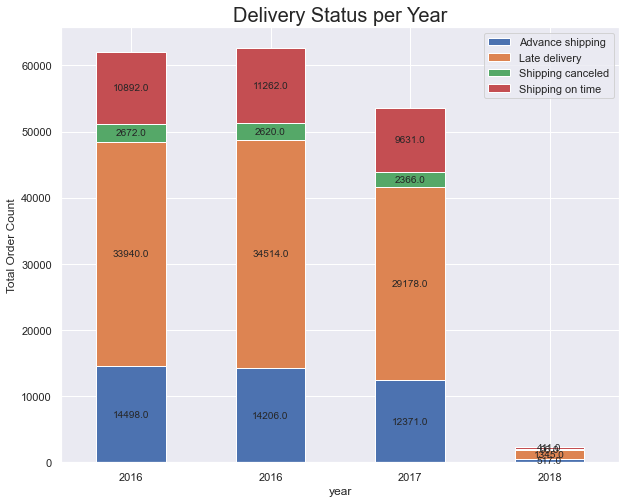

In [89]:
# Delivery Status per Year
ax = delivery_df.plot.bar(stacked = True, figsize = (10, 8))

for bar in ax.patches:
    height = bar.get_height()
    width = bar.get_width()
    x = bar.get_x()
    y = bar.get_y()
    label_text = height
    label_x = x + width / 2
    label_y = y +height / 2
    ax.text(label_x, label_y, label_text, ha = 'center', va = 'center')

ax.set_title('Delivery Status per Year', fontsize = 20)
ax.set_ylabel('Total Order Count')
ax.set_xticklabels(['2016', '2016', '2017', '2018'], rotation = 0)
ax.legend()

plt.savefig('../Images/deliveryperyear.png')
plt.show()

In [78]:
# Pivot table Delivery Status by Payment Type
delpay_df = pd.pivot_table(shipment_df, 
                           index = 'Type', 
                           columns = 'Delivery_Status', 
                           values = 'Order_Id', 
                           aggfunc = 'count')
delpay_df

Delivery_Status,Advance shipping,Late delivery,Shipping canceled,Shipping on time
Type,,,,
CASH,4809.0,11109.0,NaN,3698.0
DEBIT,16549.0,39649.0,NaN,13097.0
PAYMENT,10008.0,24004.0,NaN,7713.0
TRANSFER,10226.0,24215.0,7754.0,7688.0


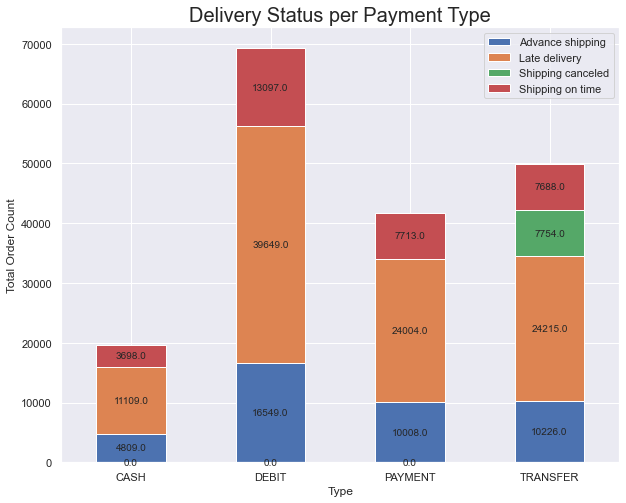

In [90]:
# Plot Delivery Status per Payment Type
ax = delpay_df.plot.bar(stacked = True, figsize = (10, 8))

for bar in ax.patches:
    height = bar.get_height()
    width = bar.get_width()
    x = bar.get_x()
    y = bar.get_y()
    label_text = height
    label_x = x + width / 2
    label_y = y +height / 2
    ax.text(label_x, label_y, label_text, ha = 'center', va = 'center')

ax.set_title('Delivery Status per Payment Type', fontsize = 20)
ax.set_ylabel('Total Order Count')
ax.set_xticklabels(['CASH', 'DEBIT', 'PAYMENT', 'TRANSFER'], rotation = 0)
ax.legend()

plt.savefig('../Images/deliveryperpayment.png')
plt.show()

In [92]:
# Pivot table Delivery Status by Order Status
order_df = pd.pivot_table(shipment_df, 
                          index = 'Order_Status',
                          columns = 'Delivery_Status',
                          values = 'Order_Id', 
                          aggfunc = 'count')
order_df

Delivery_Status,Advance shipping,Late delivery,Shipping canceled,Shipping on time
Order_Status,,,,
CANCELED,NaN,NaN,3692.0,NaN
CLOSED,4809.0,11109.0,NaN,3698.0
COMPLETE,14136.0,34199.0,NaN,11156.0
ON_HOLD,2413.0,5450.0,NaN,1941.0
PAYMENT_REVIEW,420.0,1082.0,NaN,391.0
PENDING,4857.0,11712.0,NaN,3658.0
PENDING_PAYMENT,9588.0,22922.0,NaN,7322.0
PROCESSING,5369.0,12503.0,NaN,4030.0
SUSPECTED_FRAUD,NaN,NaN,4062.0,NaN


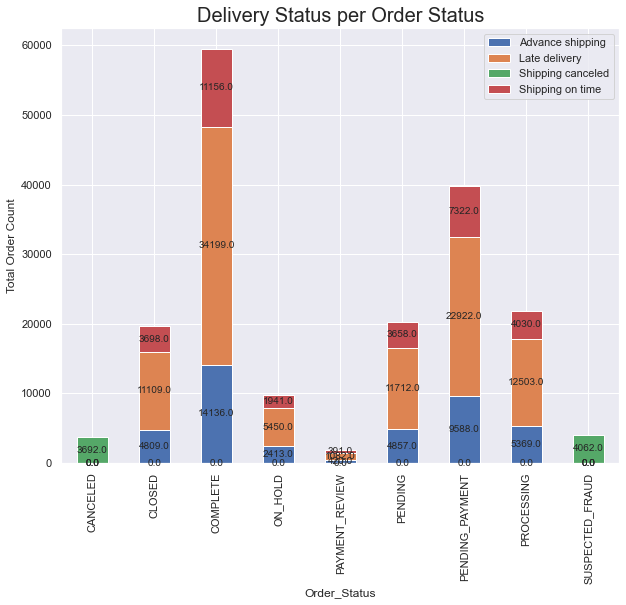

In [94]:
# Plot Delivery Status per Order Status
ax = order_df.plot.bar(stacked = True, figsize = (10,8))

for bar in ax.patches:
    height = bar.get_height()
    width = bar.get_width()
    x = bar.get_x()
    y = bar.get_y()
    label_text = height
    label_x = x + width / 2
    label_y = y +height / 2
    ax.text(label_x, label_y, label_text, ha = 'center', va = 'center')
    
ax.set_title('Delivery Status per Order Status', fontsize = 20)
ax.set_ylabel('Total Order Count')
ax.set_xticklabels(['CANCELED', 'CLOSED', 'COMPLETE', 'ON_HOLD', 'PAYMENT_REVIEW', 
                   'PENDING', 'PENDING_PAYMENT', 'PROCESSING', 'SUSPECTED_FRAUD'], rotation = 90)
ax.legend()

plt.savefig('../Images/deliveryperorder.png')
plt.show()

## Finance Dataset

In [96]:
# Creating finance dataset
finance = ['Order_Country', 'Market', 'Benefit_per_order', 'Sales_per_customer', 'Order_Item_Discount', 
           'Order_Item_Discount_Rate', 'Product_Price','Order_Item_Profit_Ratio']
finance_df = clean_df[finance]
finance_df.head()

,Order_Country,Market,Benefit_per_order,Sales_per_customer,Order_Item_Discount,Order_Item_Discount_Rate,Product_Price,Order_Item_Profit_Ratio
0,Indonesia,Pacific Asia,91.250000,314.640015,13.110000,0.04,327.75,0.29
1,India,Pacific Asia,-249.089996,311.359985,16.389999,0.05,327.75,-0.80
2,India,Pacific Asia,-247.779999,309.720001,18.030001,0.06,327.75,-0.80
3,Australia,Pacific Asia,22.860001,304.809998,22.940001,0.07,327.75,0.08
4,Australia,Pacific Asia,134.210007,298.250000,29.500000,0.09,327.75,0.45


In [97]:
# Market demand
demand_df = finance_df.groupby('Market').sum()['Sales_per_customer']
demand_df = demand_df.reset_index()
demand_df.head()

,Market,Sales_per_customer
0,Africa,2.061679e+06
1,Europe,9.769198e+06
2,LATAM,9.235762e+06
3,Pacific Asia,7.434263e+06
4,USCA,4.553500e+06


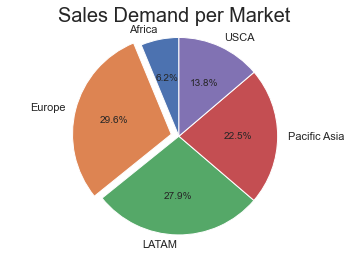

In [100]:
# creating the plot
market = demand_df['Market']
sales = demand_df['Sales_per_customer']
explode = (0, 0.08, 0, 0, 0)

plt.title('Sales Demand per Market', fontsize = 20)
plt.pie(sales, explode = explode, labels = market, 
       autopct = '%1.1f%%', startangle = 90)
plt.axis('equal')
plt.savefig('../Images/Sales_Demand_per_Market.png')
plt.show()

## Location dataset

In [102]:
# Location dataset

location = ['Type', 'Days_for_shipping_(real)', 'Days_for_shipment_(scheduled)', 'Delivery_Status', 
            'Late_delivery_risk', 'Category_Name', 'Customer_Segment', 'Latitude', 'Longitude', 
            'Market', 'Order_City', 'Order_Country', 'order_date_(DateOrders)', 'Order_Id', 
            'Order_Status', 'Product_Name', 'shipping_date_(DateOrders)', 'Shipping_Mode']

location_df = clean_df[location]
location_df.head()

,Type,Days_for_shipping_(real),Days_for_shipment_(scheduled),Delivery_Status,Late_delivery_risk,Category_Name,Customer_Segment,Latitude,Longitude,Market,Order_City,Order_Country,order_date_(DateOrders),Order_Id,Order_Status,Product_Name,shipping_date_(DateOrders),Shipping_Mode
0,DEBIT,3,4,Advance shipping,0,Sporting Goods,Consumer,18.251453,-66.037056,Pacific Asia,Bekasi,Indonesia,1/31/2018 22:56,77202,COMPLETE,Smart watch,2018-02-03 22:56:00,Standard Class
1,TRANSFER,5,4,Late delivery,1,Sporting Goods,Consumer,18.279451,-66.037064,Pacific Asia,Bikaner,India,1/13/2018 12:27,75939,PENDING,Smart watch,2018-01-18 12:27:00,Standard Class
2,CASH,4,4,Shipping on time,0,Sporting Goods,Consumer,37.292233,-121.881279,Pacific Asia,Bikaner,India,1/13/2018 12:06,75938,CLOSED,Smart watch,2018-01-17 12:06:00,Standard Class
3,DEBIT,3,4,Advance shipping,0,Sporting Goods,Home Office,34.125946,-118.291016,Pacific Asia,Townsville,Australia,1/13/2018 11:45,75937,COMPLETE,Smart watch,2018-01-16 11:45:00,Standard Class
4,PAYMENT,2,4,Advance shipping,0,Sporting Goods,Corporate,18.253769,-66.037048,Pacific Asia,Townsville,Australia,1/13/2018 11:24,75936,PENDING_PAYMENT,Smart watch,2018-01-15 11:24:00,Standard Class


In [103]:
from shapely.geometry import Point
import geopandas as gpd
from geopandas import GeoDataFrame

In [104]:
# Create point geometries
geometry = gpd.points_from_xy(location_df.Longitude, location_df.Latitude)
geo_df = gpd.GeoDataFrame(location_df[['shipping_date_(DateOrders)', 'Delivery_Status', 'Market', 
                                       'Order_Country', 'Latitude', 'Longitude', 
                                       'Order_Status']], geometry = geometry)
geo_df.head()

,shipping_date_(DateOrders),Delivery_Status,Market,Order_Country,Latitude,Longitude,Order_Status,geometry
0,2018-02-03 22:56:00,Advance shipping,Pacific Asia,Indonesia,18.251453,-66.037056,COMPLETE,POINT (-66.03706 18.25145)
1,2018-01-18 12:27:00,Late delivery,Pacific Asia,India,18.279451,-66.037064,PENDING,POINT (-66.03706 18.27945)
2,2018-01-17 12:06:00,Shipping on time,Pacific Asia,India,37.292233,-121.881279,CLOSED,POINT (-121.88128 37.29223)
3,2018-01-16 11:45:00,Advance shipping,Pacific Asia,Australia,34.125946,-118.291016,COMPLETE,POINT (-118.29102 34.12595)
4,2018-01-15 11:24:00,Advance shipping,Pacific Asia,Australia,18.253769,-66.037048,PENDING_PAYMENT,POINT (-66.03705 18.25377)


In [105]:
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))
location_df.Market.unique()

array(['Pacific Asia', 'USCA', 'Africa', 'Europe', 'LATAM'], dtype=object)

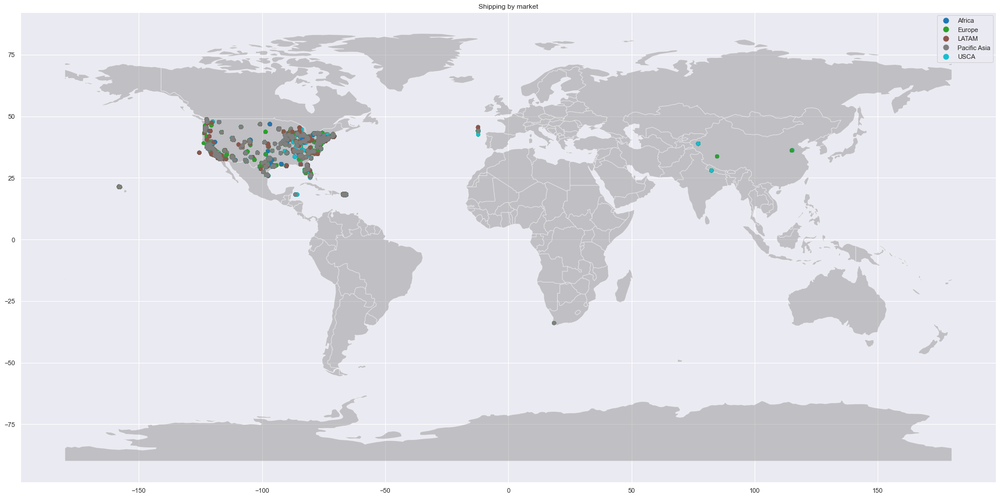

In [108]:
fig, ax = plt.subplots(figsize = (30, 24))
world.plot(ax = ax, alpha = 0.4, color = 'grey')
geo_df.plot(column = 'Market', ax = ax, legend = True)
plt.title('Shipping by market')
plt.savefig('../Images/storelocation.png')
plt.show()

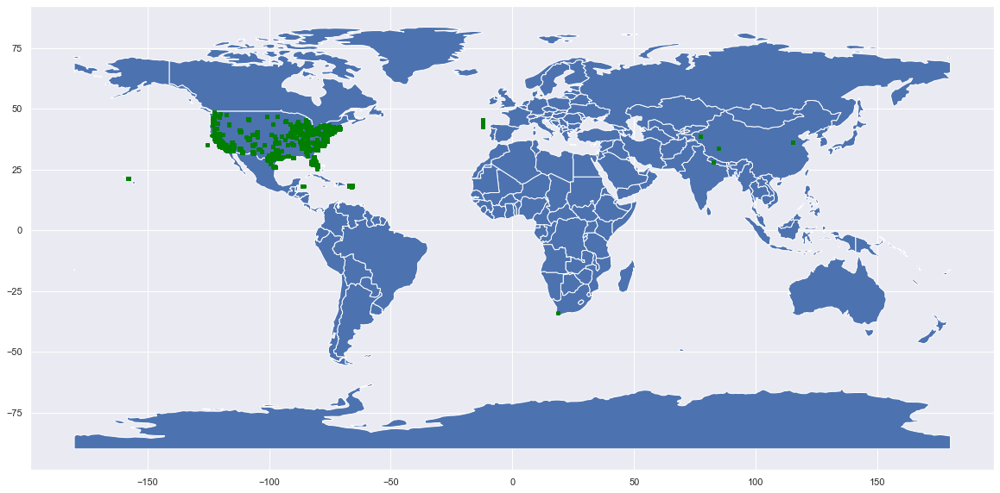

In [109]:
geometry = [Point(xy) for xy in zip(location_df['Longitude'], location_df['Latitude'])]
gdf = GeoDataFrame(location_df, geometry = geometry)

# Simple map that goes with geopandas

world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))
gdf.plot(ax = world.plot(figsize = (20, 20)), marker = 'o', color = 'green', markersize = 15);

In [111]:
import plotly.express as px

fig = px.scatter_geo(location_df, lat = 'Latitude', lon = 'Longitude', hover_name = 'Order_Status')
fig.update_layout(title = 'Store Location by Country', title_x = 1)
fig.show()